# Load packages

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt

# Making merged MERFISH object

Load in gene count and cell spatial coordinate matricies to create MERFISH scanpy object.

In [2]:
# Function for spatially rotating sections
def rotate(p, origin=(0, 0), degrees=0):
    angle = np.deg2rad(degrees)
    R = np.array([[np.cos(angle), -np.sin(angle)],
                  [np.sin(angle),  np.cos(angle)]])
    o = np.atleast_2d(origin)
    p = np.atleast_2d(p)
    return np.squeeze((R @ (p.T-o.T) + o.T).T)

In [3]:
# Section R77_4C4
counts = sc.read_csv('../data/MERFISH/raw/R77_4C4_single_cell_raw_counts.csv', first_column_names=True)
coords = pd.read_csv('../data/MERFISH/raw/R77_4C4_cell_metadata.csv', index_col = 0)
coords = coords.loc[coords['status']=='ok',['global_y','global_x']]
coords['global_y'] = -1 * coords['global_y'] 
coords.index = coords.index.astype('str')
adata_w12_4C4 = counts[coords.index, :]
coords = rotate(coords, origin=(308,-1116), degrees=15)
adata_w12_4C4.obsm["spatial"] = coords
adata_w12_4C4.obs['sample_id'] = 'R77_4C4'

In [4]:
# Section R78_4C12
counts = sc.read_csv('../data/MERFISH/raw/R78_4C12_single_cell_raw_counts.csv', first_column_names=True)
coords = pd.read_csv('../data/MERFISH/raw/R78_4C12_cell_metadata.csv', index_col = 0)
coords = coords.loc[coords['status']=='ok',['global_y','global_x']]
coords['global_y'] = -1 * coords['global_y'] 
coords.index = coords.index.astype('str')
adata_w12_4C12 = counts[coords.index, :]
coords = rotate(coords, origin=(2705,-436), degrees=18)
adata_w12_4C12.obsm["spatial"] = coords
adata_w12_4C12.obs['sample_id'] = 'R78_4C12'

In [5]:
# Section R78_4C15
counts = sc.read_csv('../data/MERFISH/raw/R78_4C15_single_cell_raw_counts.csv', first_column_names=True)
coords = pd.read_csv('../data/MERFISH/raw/R78_4C15_cell_metadata.csv', index_col = 0)
coords = coords.loc[coords['status']=='ok',['global_y','global_x']]
coords['global_y'] = -1 * coords['global_y'] 
coords.index = coords.index.astype('str')
adata_w12_4C15 = counts[coords.index, :]
coords = rotate(coords, origin=(1126,2092), degrees=10)
adata_w12_4C15.obsm["spatial"] = coords
adata_w12_4C15.obs['sample_id'] = 'R78_4C15'

In [6]:
# Create merged object with all sections
adata_merged = adata_w12_4C4.concatenate(adata_w12_4C12, adata_w12_4C15, 
                                         batch_categories=['R77_4C4', 'R78_4C12', 'R78_4C15'])

Process data following SCANPY's MERFISH analysis tutorial.

https://scanpy-tutorials.readthedocs.io/en/latest/spatial/basic-analysis.html#MERFISH-example

In [7]:
# Preprocessin and dimensionality reduction
sc.pp.normalize_per_cell(adata_merged)
sc.pp.log1p(adata_merged)
sc.pp.pca(adata_merged)
sc.pp.neighbors(adata_merged)
sc.tl.umap(adata_merged)

In [8]:
# Offset sections in spatial embedding
adata_merged.obsm['spatial'][adata_merged.obs['sample_id']=='R77_4C4', 0] = adata_merged.obsm['spatial'][adata_merged.obs['sample_id']=='R77_4C4', 0] - 8000
adata_merged.obsm['spatial'][adata_merged.obs['sample_id']=='R78_4C15', 0] = adata_merged.obsm['spatial'][adata_merged.obs['sample_id']=='R78_4C15', 0] + 4000

... storing 'sample_id' as categorical


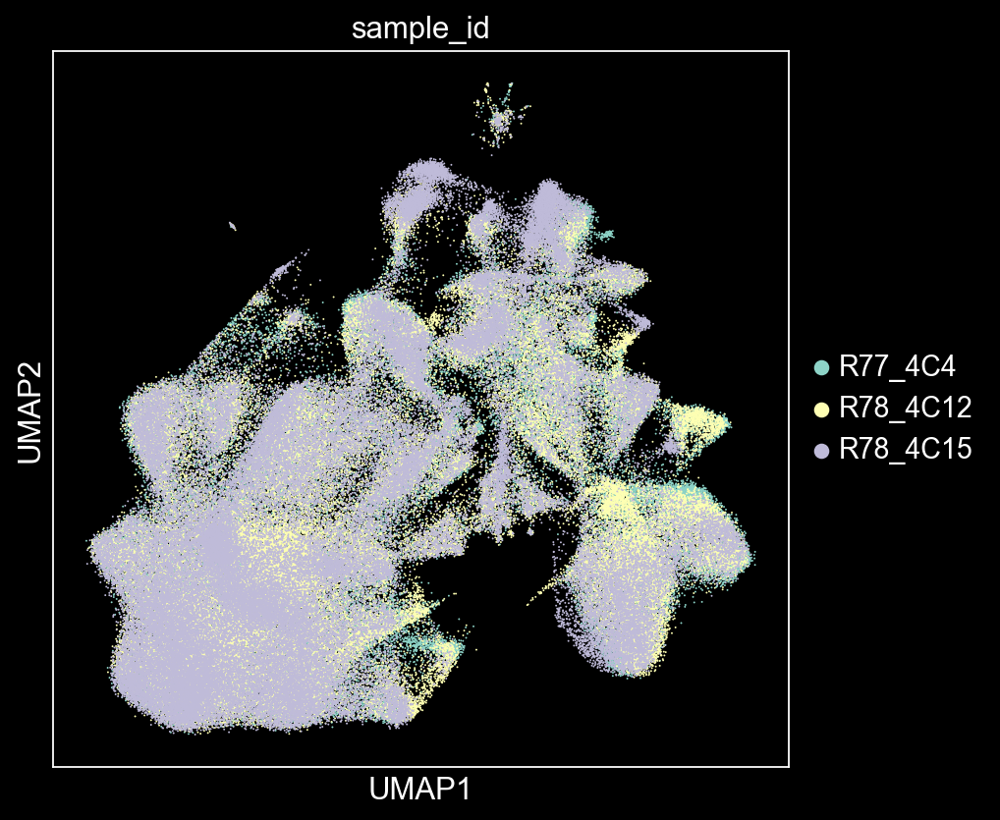

In [9]:
# Plot UMAP embedding
sc.set_figure_params(figsize=[6,6])
plt.style.use('dark_background')
sc.pl.umap(adata_merged, color="sample_id", size=3)
plt.style.use('default')

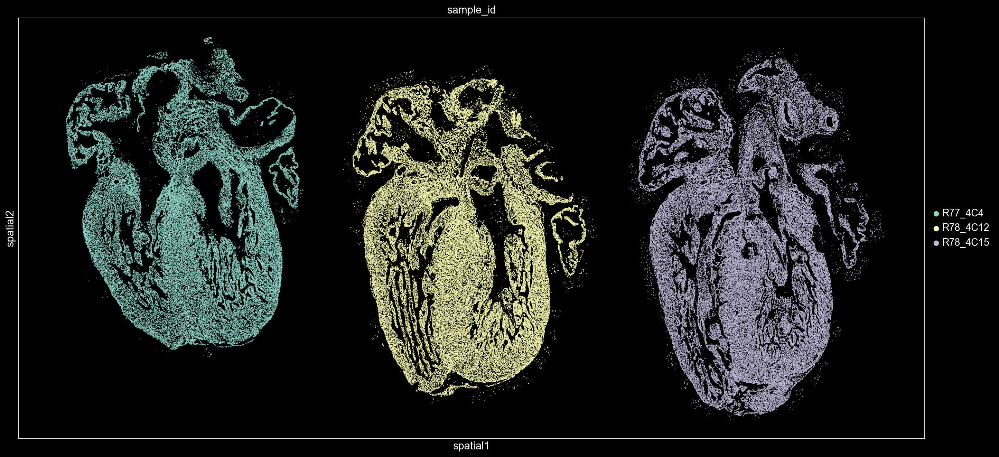

In [10]:
# Plot spatial embedding
sc.set_figure_params(figsize=[21,10])
plt.style.use('dark_background')
sc.pl.embedding(adata_merged, basis="spatial", color="sample_id", size=3)
plt.style.use('default')

In [11]:
# Write MERFISH scanpy object to file
# adata_merged.write('../data/MERFISH/scanpy_obj/merfish_w12_merged_4C4_4C12_4C15.h5ad')

# Cluster cells and annotate cell types

In [11]:
sc.tl.leiden(adata_merged, key_added="leiden", resolution=2, random_state=0)

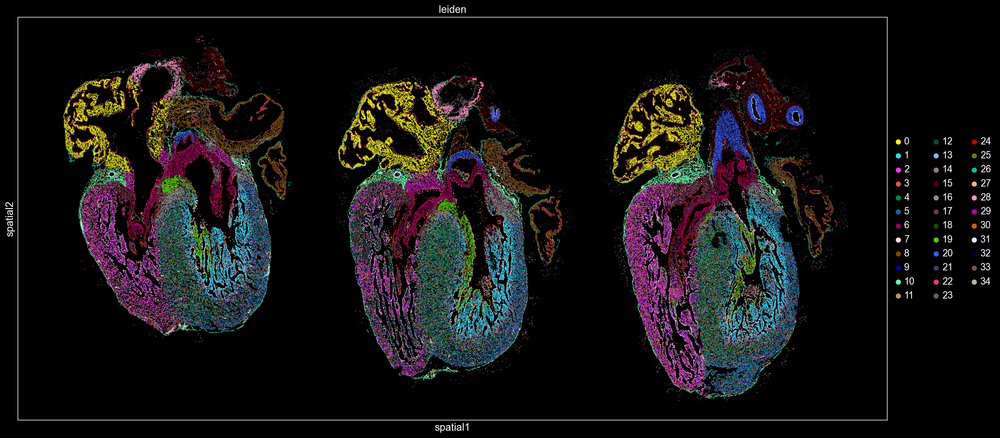

In [12]:
# Plot spatial embedding
sc.set_figure_params(figsize=[21,10])
plt.style.use('dark_background')
sc.pl.embedding(adata_merged, basis="spatial", color="leiden", size=3)
plt.style.use('default')

In [13]:
# annotate clusters
cluster_annotations = {'0':'aCM-RA', '1':'vCM', '2':'vCM', '3':'vFibro', '4':'vCM',
                       '5':'vCM', '6':'VIC', '7':'vEndocardial', '8':'aCM-LA', '9':'vCM', '10':'EPDC',
                       '11':'VE', '12':'vCM', '13':'vCM', '14':'aFibro',
                       '15':'adFibro', '16':'Valve vCM', '17':'Valve vCM', '18':'Pericyte', '19':'His-Purkinje',
                       '20':'VSMC', '21':'remove', '22':'aEndocardial', '23':'VE', '24':'VEC',
                       '25':'Compact vCM', '26':'Epicardial', '27':'remove', '28':'IFT-like', '29':'AVN-like',
                       '30':'LEC', '31':'VSMC', '32':'WBC', '33':'Neuronal-like', '34':'remove'}
adata_merged.obs['celltype'] = adata_merged.obs['leiden'].replace(cluster_annotations)

... storing 'celltype' as categorical


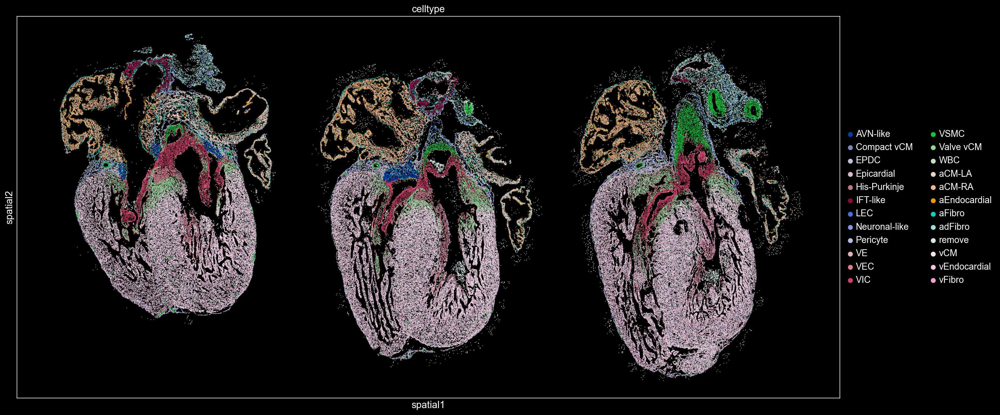

In [14]:
sc.set_figure_params(figsize=[21,10])
plt.style.use('dark_background')
sc.pl.embedding(adata_merged, basis="spatial", color="celltype", size=3)
plt.style.use('default')

Subcluster vCM cells to better annotate Trabecular and Compact vCMs

In [15]:
adata_merged_vcm = adata_merged[adata_merged.obs['celltype'].isin(['vCM','Valve vCM','Compact vCM'])]
sc.pp.pca(adata_merged_vcm)
sc.pp.neighbors(adata_merged_vcm)
sc.tl.umap(adata_merged_vcm)
sc.tl.leiden(adata_merged_vcm, key_added="leiden", resolution=1)

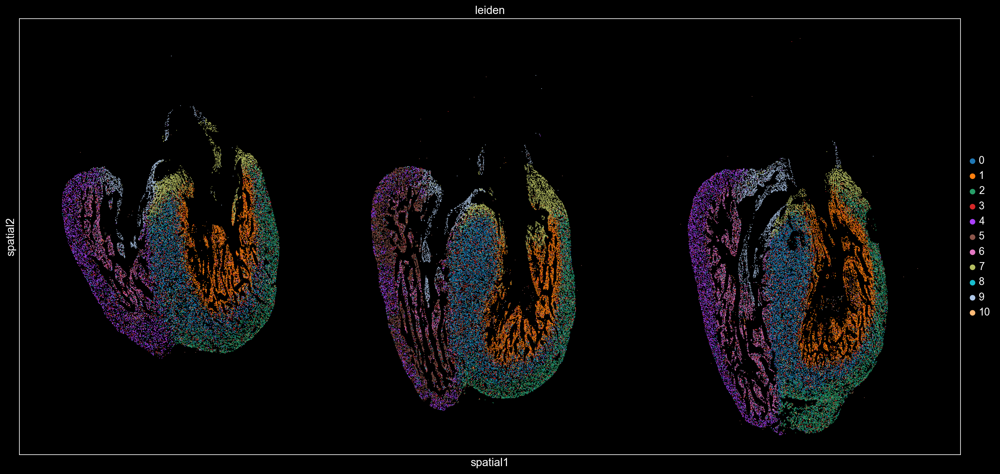

In [16]:
# Plot spatial embedding
sc.set_figure_params(figsize=[21,10])
plt.style.use('dark_background')
sc.pl.embedding(adata_merged_vcm, basis="spatial", color="leiden", size=3)
plt.style.use('default')

In [17]:
# annotate clusters
cluster_annotations = {'0':'Compact-LV', '1':'Trabecular-LV', '2':'Compact-LV', '3':'Proliferating vCM', 
                       '4':'Compact-RV', '5':'remove', '6':'Trabecular-RV', '7':'avCM-LV', '8':'Proliferating vCM', 
                       '9':'avCM-RV', '10':'remove'}
adata_merged_vcm.obs['celltype'] = adata_merged_vcm.obs['leiden'].replace(cluster_annotations)

... storing 'celltype' as categorical


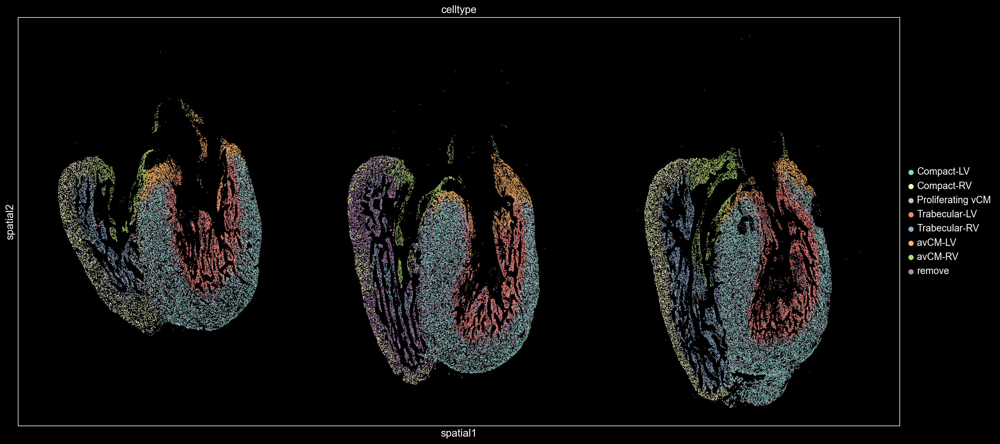

In [18]:
# Plot spatial embedding
sc.set_figure_params(figsize=[21,10])
plt.style.use('dark_background')
sc.pl.embedding(adata_merged_vcm, basis="spatial", color="celltype", size=3)
plt.style.use('default')

Transfer subclustered vCM annotations to full object.

In [19]:
adata_merged.obs['celltype'] = adata_merged.obs['celltype'].astype('str')
adata_merged.obs.loc[adata_merged_vcm.obs.index,'celltype'] = adata_merged_vcm.obs['celltype']

... storing 'celltype' as categorical


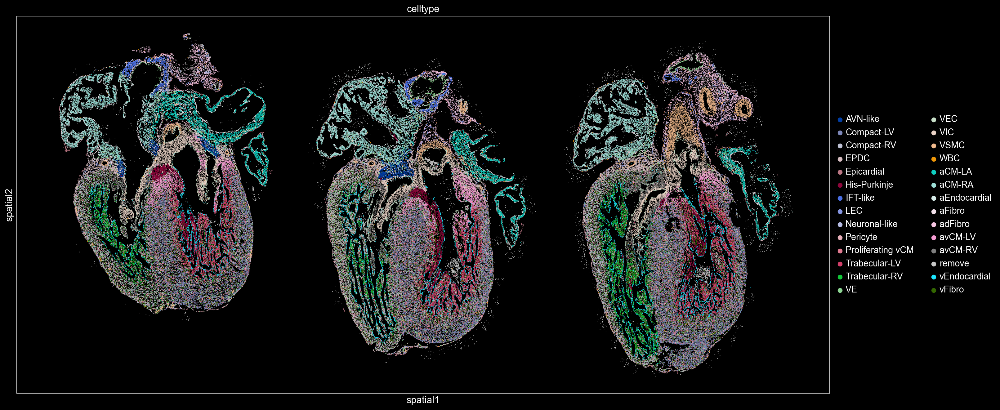

In [32]:
sc.set_figure_params(figsize=[21,10])
plt.style.use('dark_background')
sc.pl.embedding(adata_merged, basis="spatial", color="celltype", size=3)
plt.style.use('default')

In [23]:
# Write cell type annotations to file
adata_merged.obs.loc[:,['sample_id','celltype']].to_csv('../data/MERFISH/annotations/merfish_w12_merged_4C4_4C12_4C15_celltype_anno.csv')

# Read in cell type annotations
# celltype_anno = pd.read_csv('../data/MERFISH/annotations/merfish_w12_merged_4C4_4C12_4C15_celltype_anno.csv', index_col=0)
# adata_merged.obs['celltype'] = celltype_anno.loc[adata_merged.obs.index,'celltype']

# Removing non-cardiac regions

In [22]:
# read in region annotations
coords_anno_4C4 = pd.read_csv('../data/MERFISH/annotations/R77_4C4_coordinates_annotated.csv', index_col = 0)
coords_anno_4C4.index = coords_anno_4C4.index.astype('str') + '-R77_4C4'

coords_anno_4C12 = pd.read_csv('../data/MERFISH/annotations/R78_4C12_coordinates_annotated.csv', index_col = 0)
coords_anno_4C12.index = coords_anno_4C12.index.astype('str') + '-R78_4C12'

coords_anno_4C15 = pd.read_csv('../data/MERFISH/annotations/R78_4C15_coordinates_annotated.csv', index_col = 0)
coords_anno_4C15.index = coords_anno_4C15.index.astype('str') + '-R78_4C15'

coords_anno = pd.concat([coords_anno_4C4, coords_anno_4C12, coords_anno_4C15])

# filter merfish object
adata_merged.obs['filter'] = coords_anno.loc[adata_merged.obs.index,'Region']
adata_merged_filtered = adata_merged[adata_merged.obs['filter']!='Remove']
adata_merged_filtered = adata_merged_filtered[adata_merged_filtered.obs['celltype']!='Remove']

... storing 'filter' as categorical


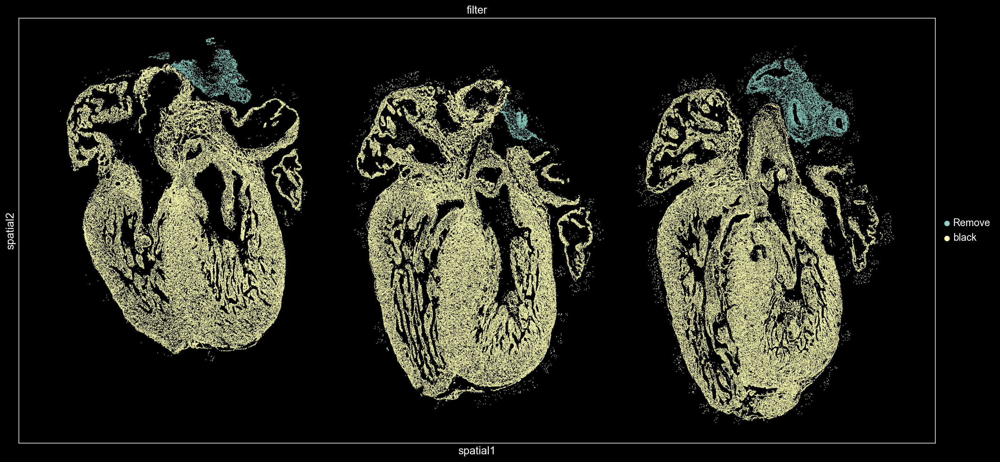

In [23]:
sc.set_figure_params(figsize=[21,10])
plt.style.use('dark_background')
sc.pl.embedding(adata_merged, basis="spatial", color="filter", size=3)
plt.style.use('default')

In [24]:
# Specify cell type colors
celltype_color = {'AVN-like':'#BD2029', 'Compact-LV':'#7382BC', 'Compact-RV':'#BDC1D5', 'DMP':'#F0ACB8', 
                  'EPDC':'#B2A157', 'Epicardial':'#F7C394', 'His-Purkinje':'#EF3D23', 'IFT-like':'#C77384', 
                  'LEC':'#645D84', 'Neuronal-like':'#2B9995', 'Pericyte':'#000000', 'Proliferating vCM':'#C19FCE', 
                  'Trabecular-LV':'#00AA4F', 'Trabecular-RV':'#7FC788', 'VE':'#1EC1E1', 'VIC':'#D0EBE7', 
                  'VSMC':'#276834', 'WBC':'#F6E0EA', 'aCM-LA':'#F499C1', 'aCM-RA':'#9E81BB', 
                  'aEndocardial':'#0072AC', 'aFibro':'#A1A738', 'adFibro':'#F2A4B2', 'avCM-LV':'#AD6D28',
                  'remove':'#808080', #########
                  'avCM-RV':'#EAB67D', 'VEC':'#1B9B8A', 'vEndocardial':'#EE4590', 'vFibro':'#F7931E'}

adata_merged_filtered.uns['celltype_colors'] = [celltype_color[celltype] for celltype in adata_merged_filtered.obs['celltype'].cat.categories]

Trying to set attribute `.uns` of view, copying.


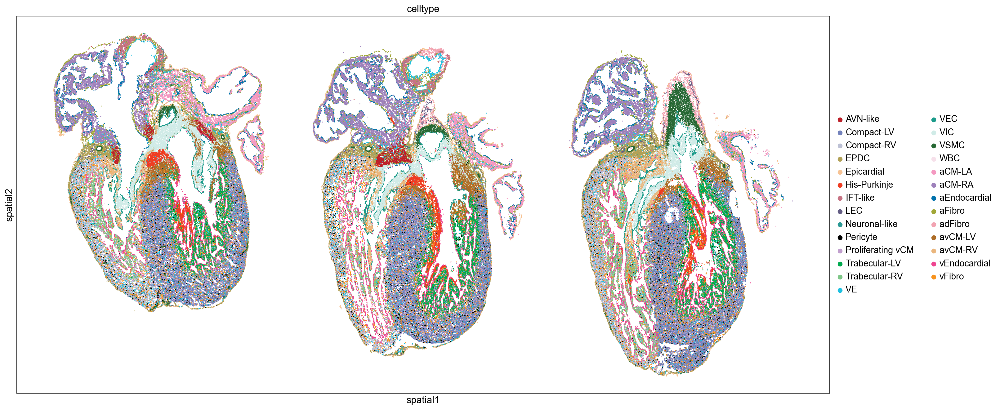

In [5]:
sc.set_figure_params(figsize=[21,10])
p = sc.pl.embedding(adata_merged_filtered, basis="spatial", color="celltype", size=8, return_fig=True)
# p.savefig('../figures/Fig1/MERFISH_spatial_celltype.pdf', bbox_inches='tight')

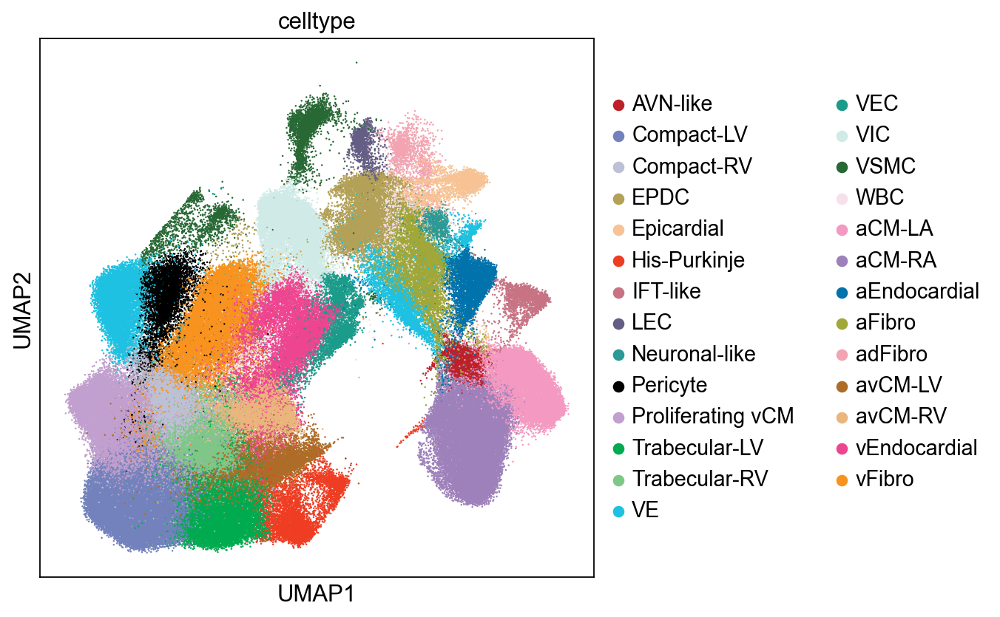

In [3]:
sc.set_figure_params(figsize=[6,6])
p = sc.pl.umap(adata_merged_filtered, color="celltype", size=5, return_fig=True)
# p.savefig('../figures/Fig1/MERFISH_umap_celltype.pdf', bbox_inches='tight')

In [2]:
# Write MERFISH scanpy object to file
# adata_merged_filtered.write('../data/MERFISH/scanpy_obj/merfish_w12_merged_4C4_4C12_4C15.h5ad')

# Load MERFISH scanpy object
adata_merged_filtered = sc.read('../data/MERFISH/scanpy_obj/merfish_w12_merged_4C4_4C12_4C15.h5ad')